<h1>Exploring the data in high dimensional space</h1>

The PDMC samples have been gated by a supervised algorithm, providing one methodology for feature extraction. Clustering is another method that can be used to this end. This is an 'unbiased' approach as events are clustered together based on simularities in high dimensional space as opposed to gating, which is biased by the choice of sequential two-dimensional plots in which to choose cell populations.

The immunova clustering module (located in `immunova.flow.clustering`) offers numerous classes for different clustering methodologies. It also provides the Explorer class, which given a dataframe generated from one of these objects, provides tools for visualisation and comparison to clinical meta-data.

The classes and their intended use are described below, we will use them in this order to explore our PDMC T cell panel experiment.

* GlobalClustering - creates a concatenated dataframe of all (or many) samples from an FCS Experiment by uniformally sampling a fixed number of cells from each. Clustering is then performed on this concatenated dataframe.
* SingleClustering - used to perform clustering on a single sample.
* MetaClustering - given that single clustering has been performed on each sample (or many samples) of an FCS Experiment, perform meta-clustering as described in the original PhenoGraph paper (calculate the centroid of each cluster [median of each feature] and run PhenoGraph clustering on these centroids.

In [2]:
import sys
if '/home/rossco/immunova' not in sys.path:
    sys.path.append('/home/rossco/immunova')
from immunova.data.mongo_setup import pd_init
from immunova.data.fcs_experiments import FCSExperiment
from immunova.data.fcs import ClusteringDefinition
from immunova.flow.clustering.main import GlobalClustering, SingleClustering, MetaClustering, Explorer
from warnings import filterwarnings
import matplotlib
import pandas as pd
import os
filterwarnings('ignore')
pd_init()

<h2>Global clustering of all PDMC samples</h2>

In [3]:
texp = FCSExperiment.objects(experiment_id='PD_T_PDMCs').get()

In [4]:
exclude = [f'{x}_pdmc_t' for x in ['209-03', '210-14', '273-01', 
                                   '298-01', '322-01', '237-06', 
                                   '302-01', '307-01']]
exclude.append('PD_T_PDMCs_sampled_data')
samples = [s for s in texp.list_samples() if s not in exclude]

In [5]:
len(samples)

37

In [6]:
features = ['CCR7', 'CD161', 'CD27', 'CD4', 'CD45RA', 'CD8', 'CXCR3',
            'FSC-A', 'FSC-H', 'FSC-W', 'PanGD', 'SSC-A', 'SSC-H', 'SSC-W',
            'Va7.2', 'Vd2']
global_cluster_def = ClusteringDefinition(clustering_uid='PDMC_TPanel_Global',
                                          method='PhenoGraph',
                                          parameters=[('k',15)],
                                          features=features,
                                          transform_method='logicle',
                                          root_population='single_Live_CD3+',
                                          cluster_prefix='PhenoGraph',
                                          meta_clustering=False)
global_cluster_def.save()

<ClusteringDefinition: ClusteringDefinition object>

In [7]:
global_cluster = GlobalClustering(clustering_definition=global_cluster_def)

In [8]:
global_cluster.load_data(experiment=texp, samples=samples, sample_n=1000)

------------ Loading flow data: PD_T_PDMCs ------------



------------ Completed! ------------


In [9]:
global_cluster.data.shape

(37000, 22)

We're left with a dataframe of concatenated single cell data (10000 cells from each sample). There is total of 331,755 data points and 22 columns. The column names are listed below:

In [8]:
explore.data.columns

Index(['CCR7', 'CD161', 'CD27', 'CD3', 'CD4', 'CD45RA', 'CD8', 'CXCR3',
       'FSC-A', 'FSC-H', 'FSC-W', 'L/D', 'PanGD', 'SSC-A', 'SSC-H', 'SSC-W',
       'Time', 'Va7.2', 'Vd2', 'original_index', 'population_label', 'pt_id'],
      dtype='object')

Before we cluster and visualise, it would be useful to associate the single cell data in this dataframe to clinical meta-data. Immunova is built around a document database where each flow file is associated directly with the clinical meta data. This means we can simple choose a common field name like 'status' or 'gender' and assoicate it to our single cell data. We can also access timeseries data and data with 'depth' such as the pathogens isolated from a patient and things like gram-status and HMBPP stauts.

We use the following methods of our Explorer object to associate single cell data to clinical meta-data:
* `load_meta` - given a field name associate to single cell data
* `load_biology_data` - summarise a blood test or some other time series data
* `load_infectious_data` - summarise the infectious agents isolate from each patient; creates four new columns, one with a list of organisms isolated, one with the common isolate type e.g. bacteria/virus/fungal, the common gram status amongst isolates, and the common HMBPP/Ribo status

In [9]:
help(explore.load_meta)

Help on method load_meta in module immunova.flow.explorer:

load_meta(variable:str) method of immunova.flow.explorer.Explorer instance
    Load meta data for each patient. Must be provided with a variable that is a field with a single value
    NOT an embedded document. A column will be generated in the Pandas DataFrame stored in the attribute 'data'
    that pertains to the variable given and the value will correspond to that of the patients.
    :param variable: field name to populate data with



In [10]:
help(explore.load_biology_data)

Help on method load_biology_data in module immunova.flow.explorer:

load_biology_data(test_name:str, summary_method:str='average') method of immunova.flow.explorer.Explorer instance
    Load the pathology results of a given test from each patient and populate 'data' accordingly. As multiple
    results may exist for one particular test, a summary method should be provided, this should have a value as
    follows:
    * average - the average test result is generated and stored
    * max - the maximum value is stored
    * min - the minimum value is stored
    * median - the median test result is generated and stored



In [11]:
help(explore.load_infectious_data)

Help on method load_infectious_data in module immunova.flow.explorer:

load_infectious_data(multi_org:str='list') method of immunova.flow.explorer.Explorer instance
    Load the bug data from each patient and populate 'data' accordingly. As default variables will be created as
    follows:
    * organism_name = If 'multi_org' equals 'list' then multiple organisms will be stored as a comma separated list
    without duplicates, whereas if the value is 'mixed' then multiple organisms will result in a value of 'mixed'.
    * organism_type = value of either 'gram positive', 'gram negative', 'virus', 'mixed' or 'fungal'
    * hmbpp = True or False based on HMBPP status (Note: it only takes one positive organism for this value to be
    True)
    * ribo = True or False based on Ribo status (Note: it only takes one positive organism for this value to be
    True)



In [12]:
explore.load_meta(variable='status')

In [13]:
explore.data.columns

Index(['CCR7', 'CD161', 'CD27', 'CD3', 'CD4', 'CD45RA', 'CD8', 'CXCR3',
       'FSC-A', 'FSC-H', 'FSC-W', 'L/D', 'PanGD', 'SSC-A', 'SSC-H', 'SSC-W',
       'Time', 'Va7.2', 'Vd2', 'original_index', 'population_label', 'pt_id',
       'status'],
      dtype='object')

In [14]:
explore.load_infectious_data()

In [15]:
explore.data.columns

Index(['CCR7', 'CD161', 'CD27', 'CD3', 'CD4', 'CD45RA', 'CD8', 'CXCR3',
       'FSC-A', 'FSC-H', 'FSC-W', 'L/D', 'PanGD', 'SSC-A', 'SSC-H', 'SSC-W',
       'Time', 'Va7.2', 'Vd2', 'original_index', 'population_label', 'pt_id',
       'status', 'organism_name', 'organism_type', 'hmbpp', 'ribo'],
      dtype='object')

In [16]:
explore.data.organism_name.unique()

array(['Staphylococcus epidermis', 'Unknown', 'Enterobacter species',
       'Coagulase Negative Staphylococcus', 'Staphylococcus aureus',
       'Yeast', 'Alpha Haemolytic Streptococcus', 'Streptococcus mitis',
       'Corynebacterium amycolatum'], dtype=object)

<h3>PhenoGraph clustering</h3>

I'll now use the PhenoGraph algorithm with a k=30 to cluster single cell data on this concatenation of all patients.

In [11]:
features = ['CCR7', 'CD161', 'CD27', 'CD4', 'CD45RA', 'CD8', 'CXCR3',
            'FSC-A', 'FSC-H', 'FSC-W', 'PanGD', 'SSC-A', 'SSC-H', 'SSC-W',
            'Va7.2', 'Vd2']

In [18]:
explore.data[features].head()

,CCR7,CD161,CD27,CD4,CD45RA,CD8,CXCR3,FSC-A,FSC-H,FSC-W,PanGD,SSC-A,SSC-H,SSC-W,Va7.2,Vd2
0,0.314096,0.143977,0.115868,0.359975,0.265690,0.256996,0.344031,0.910921,0.875326,NaN,0.092609,0.849198,NaN,0.882189,0.348076,0.163224
1,0.252092,0.124231,0.108327,0.358234,0.278323,0.233635,0.342267,0.756497,0.731804,NaN,0.082894,0.861271,NaN,0.893098,0.377044,0.146978
2,0.336972,0.189160,0.256796,0.427699,0.273953,0.686293,0.343221,0.914021,0.882587,NaN,0.059161,0.860154,NaN,0.879292,0.399576,0.165935
3,0.183506,0.124260,0.101012,0.105199,0.146271,0.132413,0.110670,0.704059,0.687184,NaN,0.052495,0.638961,NaN,0.881787,0.105355,0.116732
4,0.301040,0.120671,0.196876,0.479939,0.398108,0.342750,0.359458,0.921268,0.895870,NaN,0.022729,0.856237,NaN,0.878322,0.404114,0.193799


In [5]:
# Exclide FSC-W and SSC-H as this is missing for some samples
features = ['CCR7', 'CD161', 'CD27', 'CD4', 'CD45RA', 'CD8', 'CXCR3',
            'FSC-A', 'FSC-H', 'PanGD', 'SSC-A', 'SSC-W',
            'Va7.2', 'Vd2']

In [20]:
explore.phenograph_clustering(features=features)

Finding 30 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 144.00259685516357 seconds
Jaccard graph constructed in 21.77432131767273 seconds
Wrote graph to binary file in 18.379446268081665 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.877678
After 2 runs, maximum modularity is Q = 0.878989
After 9 runs, maximum modularity is Q = 0.880336
Louvain completed 29 runs in 692.3338713645935 seconds
PhenoGraph complete in 877.2093997001648 seconds


In [21]:
len(explore.data['PhenoGraph labels'].unique())

43

PhenoGraph generated 42 clusters. It is worth noting that PhenoGraph tends to 'over-cluster' (that is, it is a very sensitive technique) but it has the benefit of being non-parametric and is not biased by a user defined number of clusters or other hyperparamters.

<h3>Visualisation</h3>

Now that we have clustered the concatenated single cell data we can explore the data using dimensionality reduction techeniques. Immunova exclusively employs the manifold learning techniques UMAP and PHATE as they capture both local and global structure. These methods also scale easily to large datasets.

We can use UMAP and PHATE to see if any particular clusters/gated populations correlate with our clinical meta data. Any patterns found will be confirmed by embedded feature elimination and inference testing.

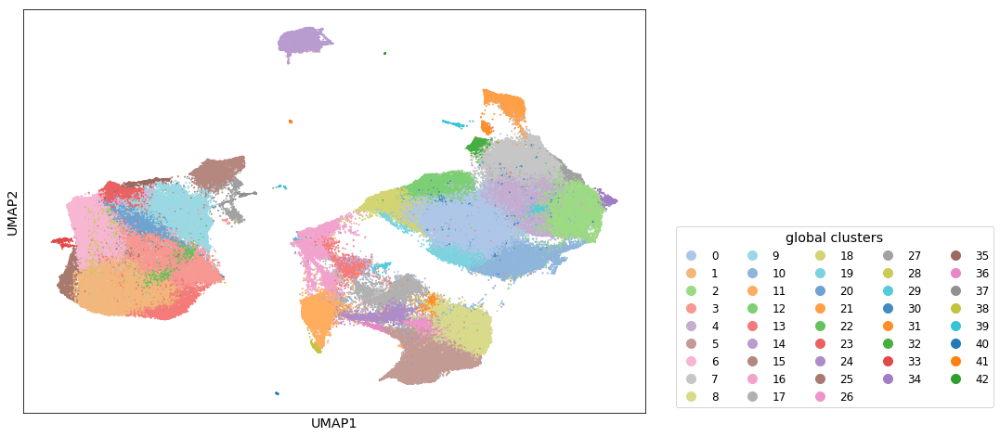

In [8]:
# Basic UMAP of global clustering
explore.scatter_plot(features=features, primary_label='global clusters', dim_reduction_method='UMAP')

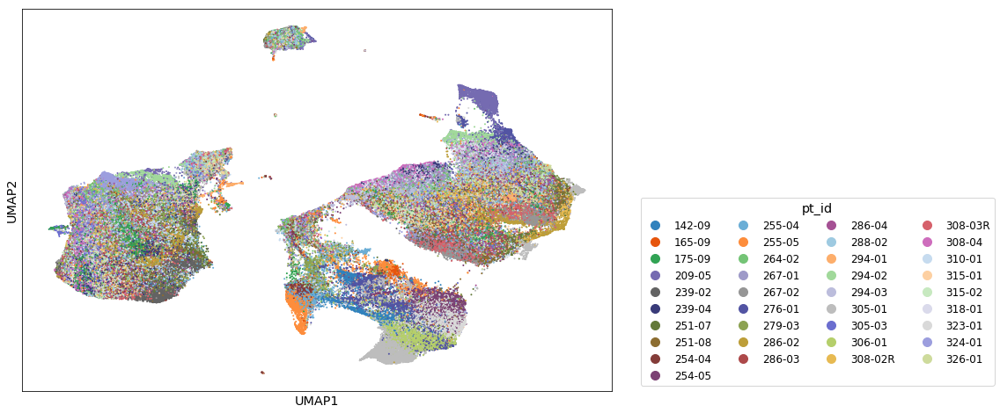

In [10]:
explore.scatter_plot(features=features, primary_label='pt_id', dim_reduction_method='UMAP')

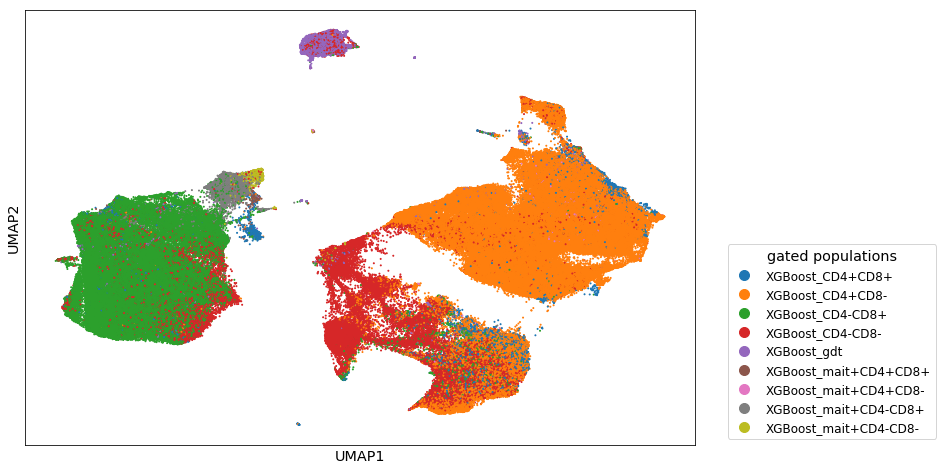

In [11]:
explore.scatter_plot(features=features, primary_label='gated populations', dim_reduction_method='UMAP')

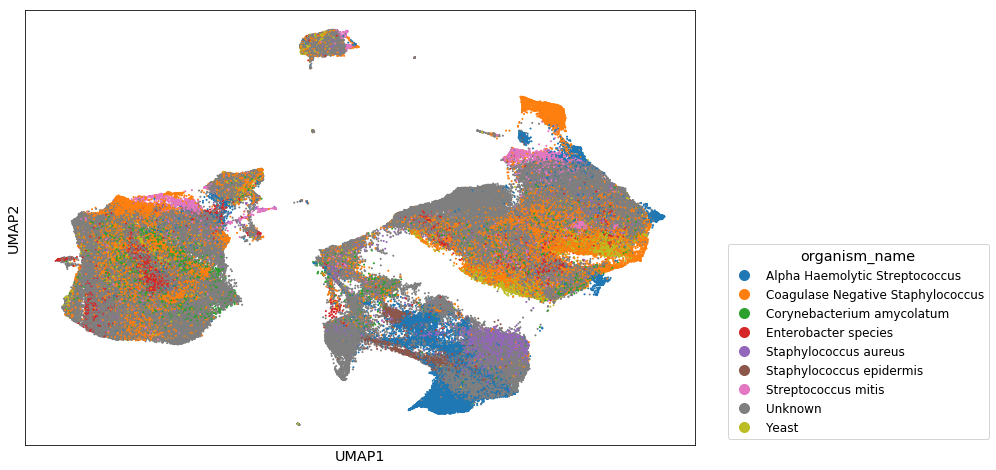

In [13]:
explore.scatter_plot(features=features, primary_label='organism_name', dim_reduction_method='UMAP')

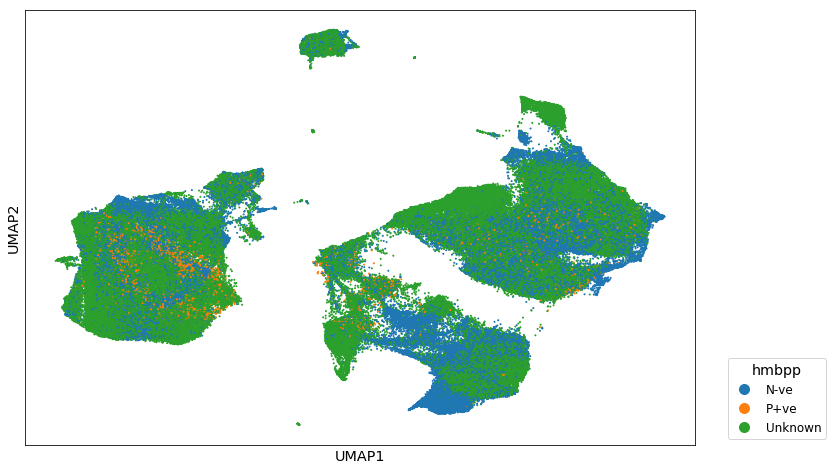

In [14]:
explore.scatter_plot(features=features, primary_label='hmbpp', dim_reduction_method='UMAP')

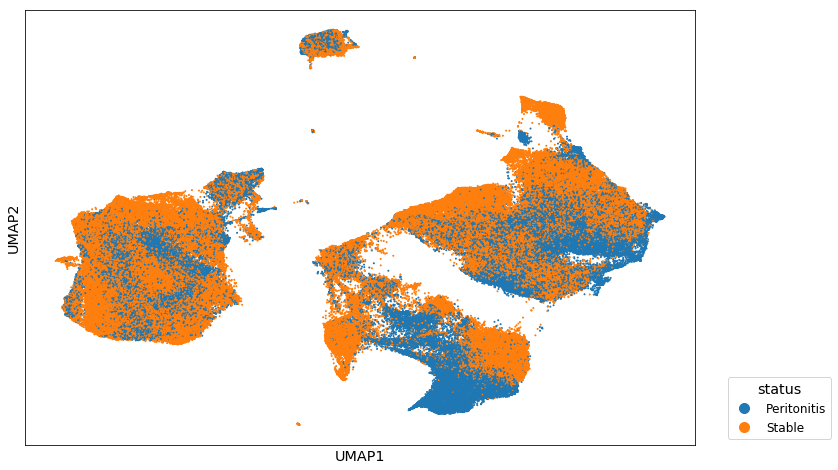

In [16]:
explore.scatter_plot(features=features, primary_label='status', dim_reduction_method='UMAP')

<h3>Saving the results</h3>

Whenever dimensionality reduction is performed the results are cached. This is because these algorithms are computationally expensive and it helps save time. If we perform dimensionality reduction again using the same method and features, the embeddings are not calculated but are just retrieved from the cache, which is much faster. It should be noted however, Explorer class only saves one method at a time, so if you change the method or features the embeddings will be recalculated and the cache overwritten.

Now we have a dataset that is clustered and dimensionality reduction has been performed and cached, we can actually save the results to the database so that we can retrieve this information at a later date without the need of rerunning calculations. Let's give this experiment a sensible name like 'Concatenated_PDMCs_TPanel_UMAP'.

In [23]:
explore.save_data(name='Concatenated_PDMCs_TPanel_UMAP')

Calculating PHATE...
  Running PHATE on 331755 cells and 14 genes.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 1002.32 seconds.
    Calculating affinities...
    Calculated affinities in 3.43 seconds.
  Calculated graph and diffusion operator in 1006.01 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 33.64 seconds.
    Calculating KMeans...
    Calculated KMeans in 39.83 seconds.
  Calculated landmark operator in 78.78 seconds.
  Calculating optimal t...
  Calculated optimal t in 2.31 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.56 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 5.34 seconds.
Calculated PHATE in 1093.00 seconds.


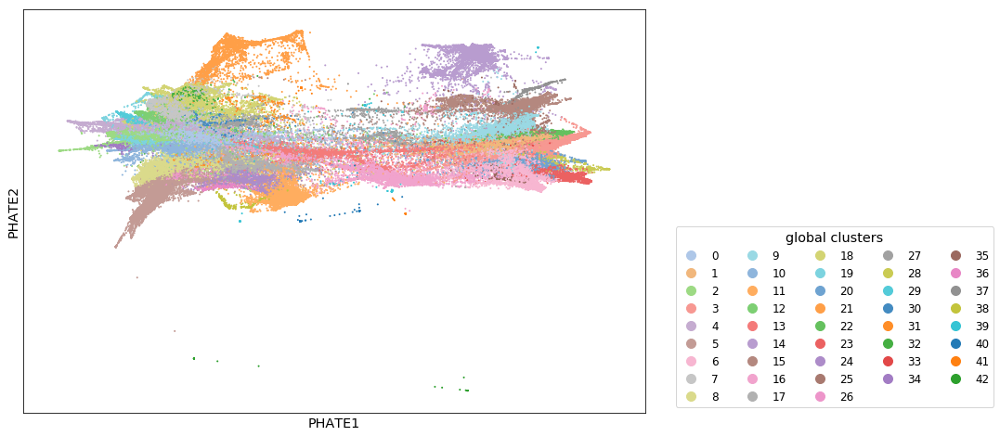

In [17]:
# Basic UMAP of global clustering
explore.scatter_plot(features=features, primary_label='global clusters', dim_reduction_method='PHATE')

In [18]:
explore.save_data(name='Concatenated_PDMCs_TPanel_PHATE')

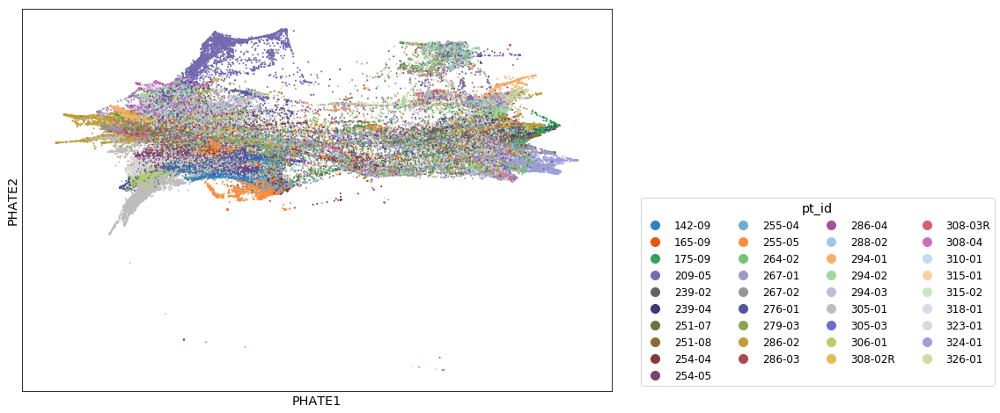

In [19]:
explore.scatter_plot(features=features, primary_label='pt_id', dim_reduction_method='PHATE')

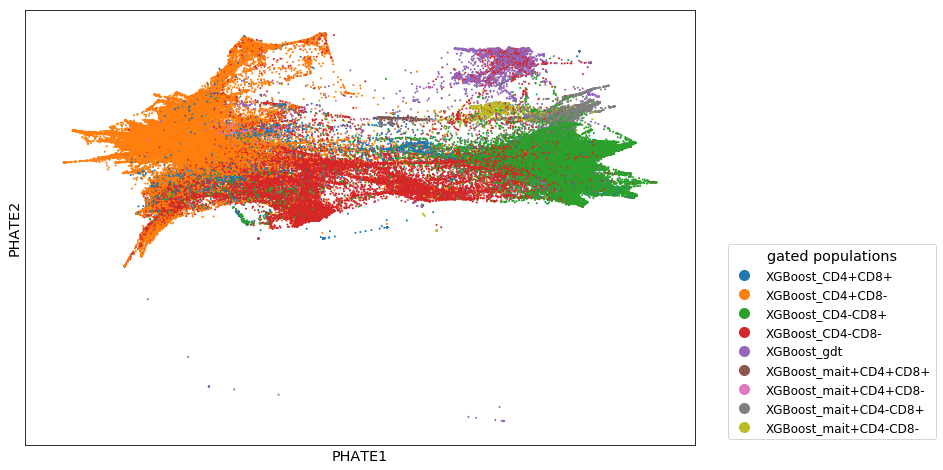

In [20]:
explore.scatter_plot(features=features, primary_label='gated populations', dim_reduction_method='PHATE')

In [3]:
features = ['CCR7', 'CD161', 'CD27', 'CD4', 'CD45RA', 'CD8', 'CXCR3', 'PanGD', 'Va7.2', 'Vd2']
explore = Explorer(load_existing='Concatenated_PDMCs_TPanel_UMAP')

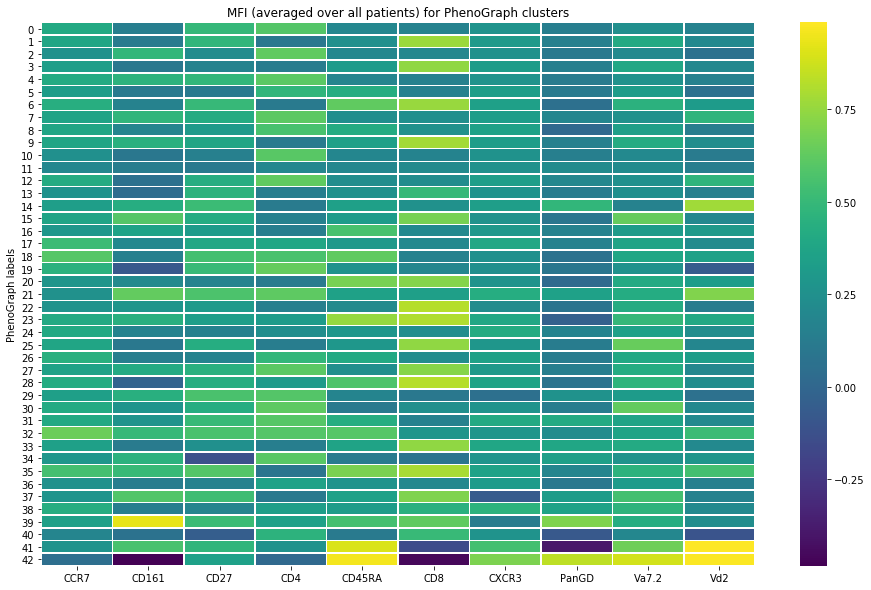

In [4]:
explore.heatmap('global clusters', features=features, clustermap=False)

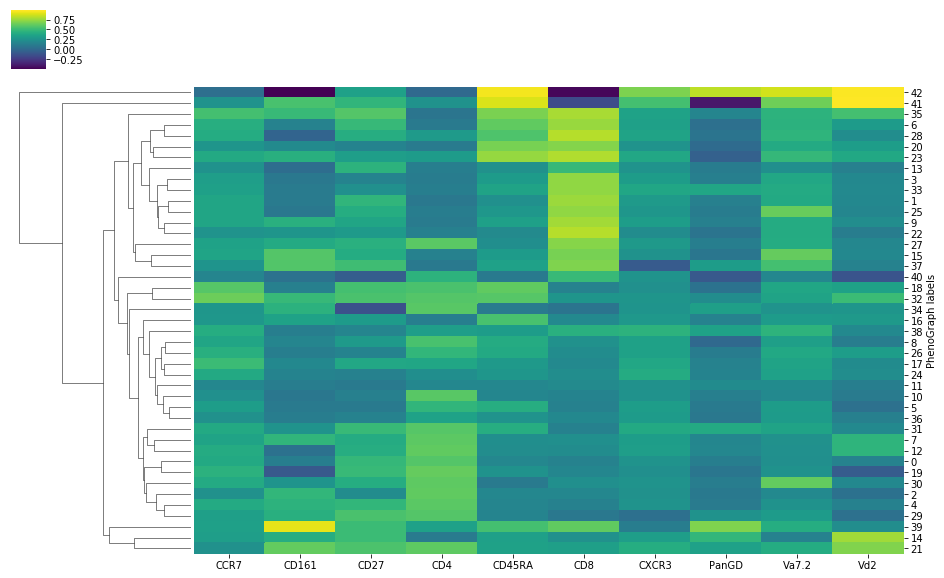

In [5]:
explore.heatmap('global clusters', features=features, clustermap=True)

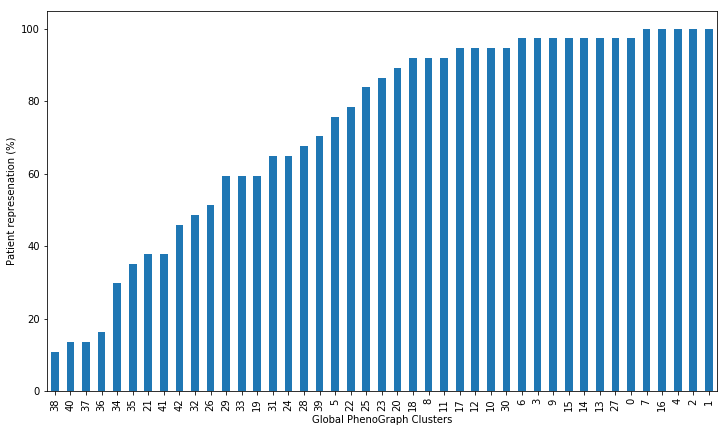

In [6]:
explore.cluster_representation(variable='patient representation')

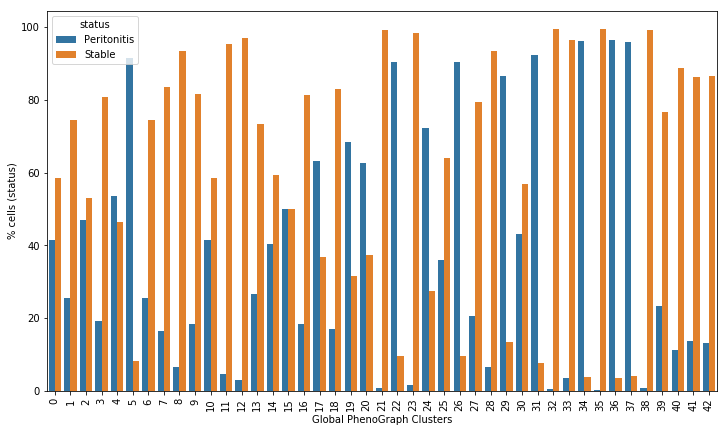

In [7]:
explore.cluster_representation(variable='status', discrete=True)

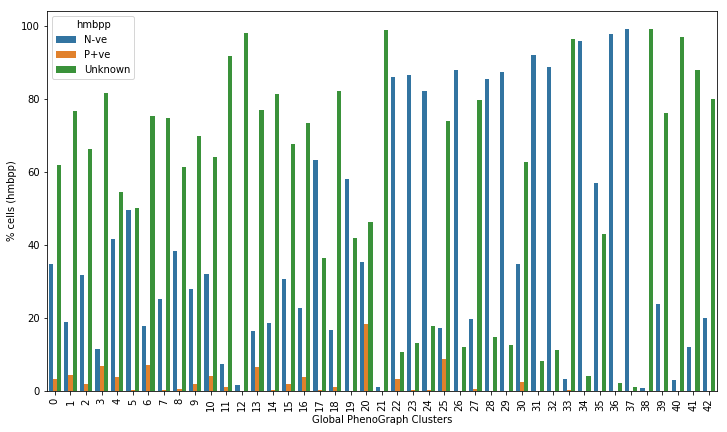

In [8]:
explore.cluster_representation(variable='hmbpp', discrete=True)

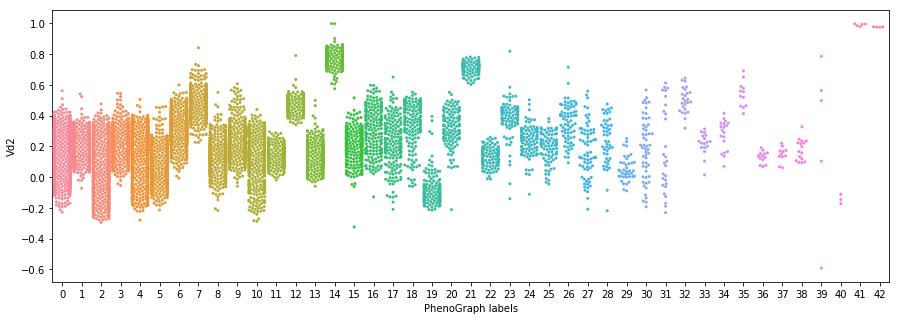

In [9]:
explore.cluster_representation(variable='Vd2', discrete=False)

<h1>Exploring interactively</h1>

In [3]:
explore = Explorer(load_existing='Concatenated_PDMCs_TPanel_UMAP')
features = explore.cache['features']
explore.select_cells(dim_reduction_method='UMAP', features=features)

Loading BokehJS ...